In [1]:
using LightGraphs, GraphIO, GraphPlot, NetworkDynamics, OrdinaryDiffEq, Plots,  Printf


#f=open("net_celegans_neural.dat")




In [2]:
using SparseArrays

function kuramoto_edge!(e, θ_s, θ_d, K, t)
    e[1] = K * sin(θ_s[1] - θ_d[1])
end

function kuramoto_vertex!(dθ, θ, edges, ω, t)
    dθ[1] = ω
    sum_coupling!(dθ, edges)
end

vertex! = ODEVertex(f! = kuramoto_vertex!, dim = 1, sym=[:θ])
edge!   = StaticEdge(f! = kuramoto_edge!, dim = 1, coupling = :directed)

StaticEdge{typeof(kuramoto_edge!)}(kuramoto_edge!, 1, :directed, [:e])

In [3]:
using LinearAlgebra, IterativeSolvers, Statistics

function get_levels(A)
    
    A= convert(Array{Float64}, A)
    
    w_in = vec(sum(A, dims=1))
   
    w_out= vec(sum(A, dims=2))
    
   
    
    u = w_in + w_out 
    
    v= w_in - w_out 
   
    Lambda=  diagm(u)-  A - transpose(A)
    
   
    Lambda[1,1]= 0 
    
    h= bicgstabl(Lambda, v, 10)
    #h=  lsmr(Lambda, v)   
       
    h= h .- minimum(h)
    
    return h
end

get_levels (generic function with 1 method)

In [4]:
function calc_troph_incoh(A,h)
    
    F=0

    for (x,y,v) in zip(findnz(A)...)
  
    
        F = F + v*(h[y] - h[x] -1 )^2
        
    end
    
    F= F/sum(A)
    
end
    
    
    
    
    

calc_troph_incoh (generic function with 1 method)

In [5]:
using SparseArrays


function maj_vote_update(x,g,N)
    
    
    x_old= copy(x)
        for i in 1:N
        
        in_connections= inneighbors(g,i)
        
        sums = 0
        for v in in_connections
        sums= sums + x_old[v]
        end
        
        x[i] = sign(sums + 0.05*x_old[i]) 
    
        #if x[i]==0
            #x[i]= sign(rand() - 0.5)
        #end
        
    end
    
    return x
end



maj_vote_update (generic function with 1 method)

In [6]:
function sis_update(x,g,N,pI,pR)
    
    
    x_new= copy(x)
    
    for i in 1:N
        
        in_connections= inneighbors(g,i)
        
       prob= rand() 
        
        
        if x[i]==1
           
         if pR> prob
                
           #println("Here") 
           x_new[i]= 0
            
            end
            
            
        else
        
        sums = 0
        for v in in_connections
        sums= sums= sums + x[v]
        end
            
          if sums>0
               
            if pI> prob
                
            
           x_new[i]= 1
              #println("Here")   
            end
                
                
            end
            
            
        end
        
        
        
       
        
    end
    
    
    x= copy(x_new)
    
    
    return x
    
end

sis_update (generic function with 1 method)

In [7]:
using LinearAlgebra, OrdinaryDiffEq, Random
using Arpack
using SNAPDatasets


number=200



updates=50

#T_list= LinRange(0.025, 8, number)




#T_list= 1.2*ones(number)

B=0

F_list = zeros(0)





time = LinRange(0, updates, updates)



state_list = zeros(0)


#stop = 5

#w_in=1

#net_celegans_neural.dat

#g = loadsnap(:soc_slashdot0902_d)

g = loadgraph("net_celegans_neural.dat", "SimpleDiGraph", EdgeListFormat())
#g = loadgraph("wiki-Vote.txt", "SimpleDiGraph", EdgeListFormat())



#g = loadgraph("soc-Slashdot0902.txt", "SimpleDiGraph", EdgeListFormat())

#g = loadgraph("net_moreno_highschool.dat", "SimpleDiGraph", EdgeListFormat())    
#g= erdos_renyi(1000, 10*1000, is_directed=true)    
N=nv(g) 

A = ((adjacency_matrix(g)))    

println("Loaded") 
    
    
h = get_levels(A)
    
F= calc_troph_incoh(A,h)    
append!( F_list, F )  
    
#println(maximum(real(eigvals(Matrix(A)))))

#ω =   zeros(N)     

ω =   randn(N)  

pI = 0.2

pR = 0.1
    
K_overall = 5
    
#x0 =  zeros(0) 
    

frac= floor(Int,0.0*N)
    


sorted = reverse(sortperm(h))    
    

    
    
x0= pi*ones(N)
   
   
for b in 1:frac
  
    x0[sorted[b]]= 0.0
    
    
    #println(h[sorted[b]])
    end

    
x= copy(x0) 




#for i in 1:updates
        
     #x = maj_vote_update(x,g,N)
       
        
      #append!(state_list, sum(x))    
        
    #end
        
nd! = network_dynamics(vertex!, edge!, g, parallel=true);        
        
w_in = vec(sum(A, dims=1))      


edge_k = zeros(0)        

    for e in edges(g)
        append!(edge_k, 10/(  size(inneighbors(g,dst(e)))[1]))
            
        end
        
L=ne(g)

K= edge_k*(L/N)*K_overall
        
p  = (ω, K);


tspan = (0., 1000.)
prob = ODEProblem(nd!, x0, tspan, p)
sol = solve(prob, Tsit5())
    
    
println("Done 1 Update")    
 







Loaded
Done 1 Update


In [8]:
using Polynomials, SpecialFunctions




g1= copy(g)

g2=copy(g)

strong_list = zeros(0)

strong_list_rand = zeros(0) 


using LinearAlgebra
using Arpack

N=size(A)[1]
println(N)
diffs= zeros(0)
edge_rem= 0

x_list= zeros(0)
y_list =zeros(0)

for (c,y,v) in zip(findnz(A)...)
  
    
        d= (h[y] - h[c] )
        append!(diffs,d)
        append!(x_list,c)
        append!(y_list,y)
       
    end


L= sum(A)

#println(diffs)

j = (sortperm(diffs))

x_list= floor.(Int,x_list[j])

y_list=  floor.(Int,y_list[j])


arg= - sqrt(-F +1)/(F*(2)) 

erf_function= 0.5*(1 + erf(arg))

beta = erf_function 

rand_j= shuffle(j)



x_list_rand= (x_list[rand_j])

y_list_rand= (y_list[rand_j])

#println(diffs[j])

weak_list= zeros(0)
weak_rand=zeros(0)


L_list=zeros(0)
#for i in 1:(floor(Int,beta*L))
    
for i in 1:(floor(Int,L*0.2))
    #println(i)
    #strong = strongly_connected_components(g1)   
    #append!(strong_list, maximum(size.(strong))[1]/N)
    
    #weak = weakly_connected_components(g1)
    #append!(weak_list, maximum(size.(weak))[1]/N)
    rem_edge!(g1, x_list[i],y_list[i])
    
     #strong_rand = strongly_connected_components(g2)   
    #append!(strong_list_rand, maximum(size.(strong_rand))[1]/N)
    #weak_2 = weakly_connected_components(g2)
    #append!(weak_rand, maximum(size.(weak_2))[1]/N)
    
    rem_edge!(g2, x_list_rand[i],y_list_rand[i])
    
    
    #append!(L_list, i)
end


x0= 2*pi*rand(N)
   
   
for b in 1:frac
  
    x0[sorted[b]]= 0.0
    
    
    #println(h[sorted[b]])
    end

    
x= copy(x0) 




#for i in 1:updates
        
     #x = maj_vote_update(x,g,N)
       
        
      #append!(state_list, sum(x))    
        
    #end
        
nd! = network_dynamics(vertex!, edge!, g1, parallel=true);        
        
w_in = vec(sum(A, dims=1))      


edge_k = zeros(0)        

    for e in edges(g1)
        append!(edge_k, 10/(  size(inneighbors(g1,dst(e)))[1]))
            
        end
        
L=ne(g1)

K= edge_k*(L/N)*K_overall
        
p  = (ω, K);


tspan = (0., 300.)
prob = ODEProblem(nd!, x0, tspan, p)
sol_no_back = solve(prob, Tsit5())
    



297


retcode: Success
Interpolation: specialized 4th order "free" interpolation
t: 27515-element Vector{Float64}:
   0.0
   0.00389092930392294
   0.005759928104838963
   0.008782823682157308
   0.01158924051674384
   0.01463856879614575
   0.01766384639522275
   0.021273673384582303
   0.02495468359763604
   0.02904078068818785
   0.03357605477034714
   0.038746342767527454
   0.04452783044016297
   ⋮
 299.88342625893983
 299.8950018036145
 299.9063652809414
 299.91596112996524
 299.9257700085923
 299.9364159127265
 299.9477919641223
 299.9594947619077
 299.97114856300306
 299.98258749616485
 299.993820011482
 300.0
u: 27515-element Vector{Vector{Float64}}:
 [5.476693913373611, 4.118471472659153, 5.8052656515892584, 0.21077149355179114, 1.3614450819510473, 1.578330722979463, 4.402620235034392, 0.10204604473553748, 2.031208053551149, 0.9639612825963113  …  4.21618360991898, 3.58733025888996, 0.6318469426618577, 4.26737360930722, 5.1300537697820054, 2.1963001131284723, 1.6253646835298499, 0.

In [9]:
x0= 2*pi*rand(N)
   
   
for b in 1:frac
  
    x0[sorted[b]]= 0.0
    
    
    #println(h[sorted[b]])
    end

    
x= copy(x0) 




#for i in 1:updates
        
     #x = maj_vote_update(x,g,N)
       
        
      #append!(state_list, sum(x))    
        
    #end
        
nd! = network_dynamics(vertex!, edge!, g2, parallel=true);        
        
w_in = vec(sum(A, dims=1))      


edge_k = zeros(0)        

    for e in edges(g2)
        append!(edge_k, 10/(  size(inneighbors(g2,dst(e)))[1]))
            
        end
        
L=ne(g2)

K= edge_k*(L/N)*K_overall
        
p  = (ω, K);


tspan = (0., 300.)
prob = ODEProblem(nd!, x0, tspan, p)
sol_random = solve(prob, Tsit5())
    

retcode: Success
Interpolation: specialized 4th order "free" interpolation
t: 56883-element Vector{Float64}:
   0.0
   0.0024519435911366885
   0.004251361435677528
   0.006628277527957236
   0.008994540285907873
   0.011996548823979119
   0.015138637706554173
   0.01859546182509881
   0.02214151548502849
   0.026168916008239857
   0.029924531310091
   0.03406633543475785
   0.03838194867120851
   ⋮
 299.95346334236496
 299.9581359073343
 299.9627673302113
 299.9674399744316
 299.9720714256972
 299.97674414851343
 299.98137562812565
 299.98604843012157
 299.9906799383545
 299.9953528198084
 299.9999843563291
 300.0
u: 56883-element Vector{Vector{Float64}}:
 [2.2901365487134213, 5.412085250247775, 3.9961990477449514, 3.3003858222531344, 2.7310255392434644, 1.5034470621848794, 2.5065062860277223, 1.891013662298148, 5.605687884419476, 3.9297188990809095  …  4.645642509716311, 5.675784910369883, 0.15480303092479727, 0.32169667311152894, 1.3330751070061262, 4.903210347958539, 2.132152428840

In [10]:
x0= ones(N)
   
sorted = reverse(sortperm(h))     
for b in 1:frac
  
    x0[sorted[b]]= -1
    
    
    #println(h[sorted[b]])
    end

    
x= copy(x0) 



x= copy(x0) 


state_no_back_top = zeros(0)

for i in 1:updates
        
     x = maj_vote_update(x,g1,N)
       
        
      append!(state_no_back_top, sum(x))    
        
    end

In [11]:
sorted = (sortperm(h))  

state_low = zeros(0)
x0= ones(N)
   
    
for b in 1:frac
  
    x0[sorted[b]]= -1
    
    
    #println(h[sorted[b]])
    end

    
x= copy(x0) 




for i in 1:updates
        
     x = maj_vote_update(x,g,N)
       
        
      append!(state_low, sum(x))    
        
    end
        

In [12]:
x0= ones(N)

sorted = reverse(sortperm(h))     
for b in 1:frac
  
    x0[sorted[b]]= -1
    
    
    #println(h[sorted[b]])
    end

    




x= copy(x0) 


state_random_removed_high = zeros(0)

for i in 1:updates
        
     x = maj_vote_update(x,g2,N)
       
        
      append!(state_random_removed_high, sum(x))    
        
    end

In [13]:
x0= ones(N)

sorted = (sortperm(h))     
for b in 1:frac
  
    x0[sorted[b]]= -1
    
    
    #println(h[sorted[b]])
    end

    
x= copy(x0) 






state_random_removed = zeros(0)

for i in 1:updates
        
     x = maj_vote_update(x,g2,N)
       
        
      append!(state_random_removed, sum(x))    
        
    end

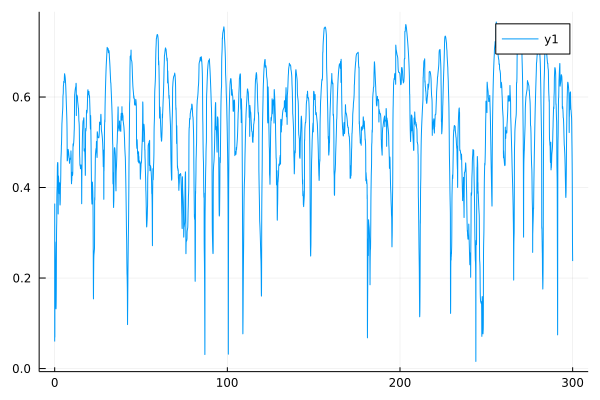

In [14]:
r_no_back= zeros(0)
for i in 1:size(sol_no_back)[2]
    append!(r_no_back, abs(sum(exp.(sol_no_back[:,i]*im))))
end

plot(sol_no_back.t,r_no_back/N)

#savefig("High_school_maj_vote_time_series.pdf")

In [15]:
r_random= zeros(0)
for i in 1:size(sol_random)[2]
    append!(r_random, abs(sum(exp.(sol_random[:,i]*im))))
end





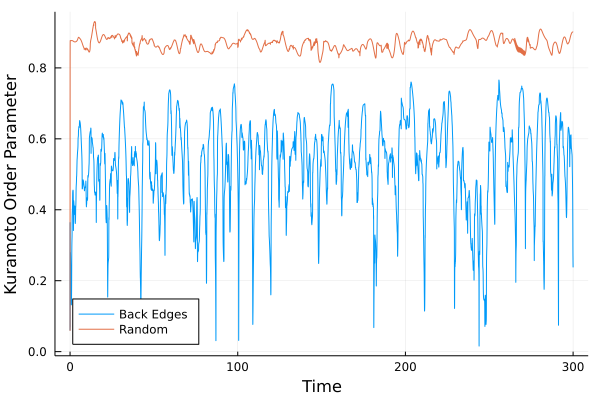

In [31]:
plot(sol_no_back.t,r_no_back/N, label="Back Edges", legend=:bottomleft, ylabel="Kuramoto Order Parameter", xlabel="Time")


plot!(sol_random.t,r_random/N, label="Random")

#savefig("Time_series_Kuramoto_3_0_2pi.pdf")

In [17]:
plot(time,state_list./N, legend=:right,label="Full Network: High Level Start",lw=2, ylabel="Fraction of Infected Nodes")

plot!(time,state_low./N, label="Full Network: Low level start", lw=2)


plot!(time,state_no_back_top./N, label="Back Edges Removed: High level start", lw=2)

plot!(time,state_no_back./N, label="Back Edges Removed: Low level start",lw=2, xlabel="Timesteps")






#savefig("SIS_demonstration_2.pdf")

LoadError: UndefVarError: state_no_back not defined

In [18]:
strong = strongly_connected_components(g1)   
maximum(size.(strong))[1]

1

In [19]:
strongly_connected_components(g1)  

297-element Vector{Vector{Int64}}:
 [296]
 [169]
 [150]
 [168]
 [146]
 [274]
 [282]
 [225]
 [276]
 [227]
 [277]
 [228]
 [278]
 ⋮
 [283]
 [284]
 [285]
 [286]
 [287]
 [288]
 [289]
 [290]
 [291]
 [292]
 [293]
 [294]

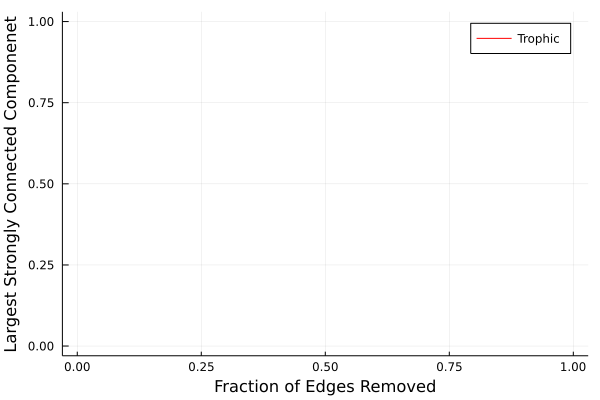

In [20]:
plot(L_list, strong_list, label="Trophic",color="red", xlabel="Fraction of Edges Removed", ylabel="Largest Strongly Connected Componenet")


In [21]:
using Plots

plot(T_list,F_list, seriestype = :scatter, legend = false, xlabel= "Temperatue",

ylabel="Trophic Incoherence", title= "Julia Network Generation")

#savefig("Julia_generation_log_space.pdf")

LoadError: UndefVarError: T_list not defined

In [22]:
#println(eig_list)

plot(F_list, eig_list, seriestype = :scatter, legend = false, xlabel= "Trophic Incoherence",

ylabel="Spectral Radius", title= "Spectral Radius")


#savefig("Julia_generation_Spec_radius_logspace_2.pdf")

LoadError: UndefVarError: eig_list not defined

In [23]:
plot(F_list, state_list/N, seriestype = :scatter, legend = false, xlabel= "Trophic Incoherence",

ylabel="Average State of System", title= "Majority Vote Dynamics", ylim=(-1.05,1.05))


#savefig("Majority_Vote_N_500_lowest_5_percent_GRS3.pdf")

DivideError: DivideError: integer division error

In [24]:
plot(F_list, cos.(phase_list), seriestype = :scatter, legend = false, xlabel= "Trophic Incoherence",

ylabel="Cosine of Average Phase", title= "Final Phase when the lowest tenth modified")

#savefig("Kuramoto_0.1_controls_dynamics_2.pdf")

LoadError: UndefVarError: phase_list not defined

In [25]:
plot(eig_list, r_list, seriestype = :scatter, legend = false, xlabel= "Spectral Radius",

ylabel="R Phase Coherence", title= "Oscillator Synchronization Spectral Radius")

LoadError: UndefVarError: eig_list not defined

In [26]:
sol[:,1]

297-element Vector{Float64}:
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793
 ⋮
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793
 3.141592653589793

In [27]:
println(size(sol)[2])
r= zeros(0)
for i in 1:size(sol)[2]
    append!(r, abs(sum(exp.(sol[:,i]*im))))
end

255652


In [28]:
plot(sol.t,r/N)



In [29]:
plot(sol[1,:])

plot!(sol[2,:])

plot!(sol[70,:])

plot!(sol[50,:])